In [1]:
import scanpy as sc

# Configuration (using the file path from previous steps)
INPUT_FILE = "../../data/Kidney_ST/Kidney_CosMx_BANKSY_Annotated_Final.h5ad"
CELL_TYPE_KEY = 'cellType_CosMx_2'

# Load the AnnData object
try:
    adata = sc.read_h5ad(INPUT_FILE)
except FileNotFoundError:
    print(f"Error: File not found at {INPUT_FILE}. Please check the path.")
    # Exit or handle error gracefully

# 1. Access the observation column (adata.obs)
# 2. Extract the unique values from the cell type column
all_cell_types = adata.obs[CELL_TYPE_KEY].astype(str).unique()

print(
    f"✅ Found {len(all_cell_types)} unique cell types under '{CELL_TYPE_KEY}':\n")
# Sort the list for easier reading
for cell_type in sorted(all_cell_types):
    print(f"* {cell_type}")


✅ Found 17 unique cell types under 'cellType_CosMx_2':

* DCT
* Endothelium
* Fibro
* IC/DCT
* Immune
* Injured TAL
* PC
* PEC
* PT
* Podo
* TAL
* VSMC/Mes
* iPT_0
* iPT_1
* iPT_2
* iPT_3
* iPT_4


stop here 

Loading data from ../../data/Kidney_ST/Kidney_CosMx_BANKSY_Annotated_Final.h5ad...


Filtered to 83204 cells (Injured + Immune types).

--- Starting MuSpAn TCM Calculation ---
TCM Calculation complete.

--- Extracting Hotspots for CellPhoneDB ---
Cells in entire tissue: 83204
Cells in hotspots (> 1.5): 61664
Export Success! Files saved to ../../analysis/05_Interaction_Hotspots_SpatialMap_WholeSlide
1. meta_hotspot.txt
2. counts_hotspot.txt

--- Generating Plots ---
Plot saved.


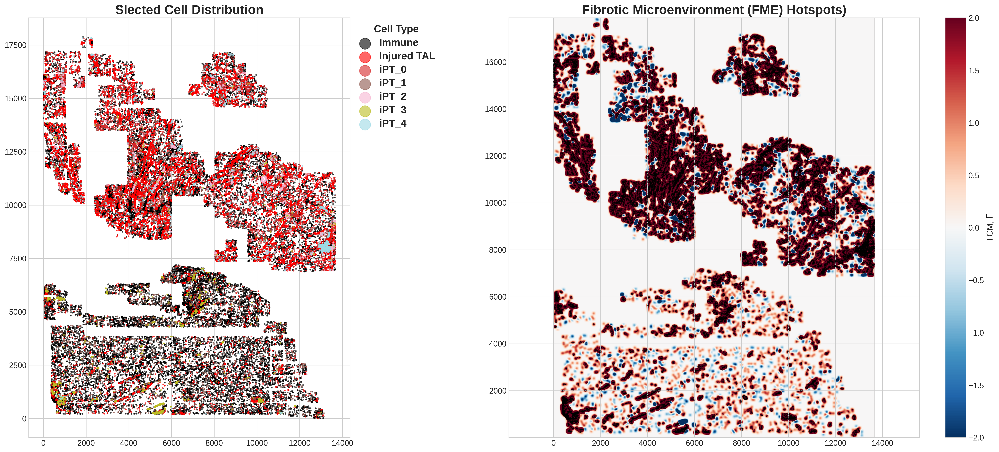

In [20]:
import os
import muspan as ms
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

# ==========================================
# 1. CONFIGURATION
# ==========================================
INPUT_FILE = "../../data/Kidney_ST/Kidney_CosMx_BANKSY_Annotated_Final.h5ad"
OUTPUT_DIR = "../../analysis/05_Interaction_Hotspots_SpatialMap_WholeSlide"
CELL_TYPE_KEY = 'cellType_CosMx_2'

# TCM settings
RECRUITMENT_THRESHOLD = 1.5  # TCM score >= 1.5 indicates high recruitment
ROI_RADIUS = 50              # Radius to check for neighbors
KERNEL_RADIUS = 100          # Smoothing kernel size

# Define cell types to analyze
ALL_CELL_TYPES = [
    'Injured TAL',
    'Immune',
    'iPT_0', 'iPT_1', 'iPT_2', 'iPT_3', 'iPT_4'
]

# Define Populations for the interaction (Source vs Target)
INJURED_POPULATION = [c for c in ALL_CELL_TYPES if c.startswith(
    'iPT_') or c == 'Injured TAL']
IMMUNE_LABEL = "Immune"

# Setup
os.makedirs(OUTPUT_DIR, exist_ok=True)
plt.rcParams['figure.dpi'] = 300
plt.style.use('seaborn-v0_8-whitegrid')

# ==========================================
# 2. HELPER FUNCTION: MAP GRID TO CELLS
# ==========================================


def assign_tcm_to_cells(tcm_grid, cell_coords):
    """
    Maps the 2D TCM grid score back to each cell's spatial coordinate.
    """
    if tcm_grid.ndim != 2:
        return np.full(cell_coords.shape[0], np.nan)

    # Determine spatial extent
    min_x, min_y = cell_coords.min(axis=0)
    max_x, max_y = cell_coords.max(axis=0)

    ny, nx = tcm_grid.shape
    dx = (max_x - min_x) / nx
    dy = (max_y - min_y) / ny

    assigned_scores = np.full(cell_coords.shape[0], np.nan)

    # Map coordinates to grid indices
    # x coordinate -> column index (0 to nx)
    # y coordinate -> row index (0 to ny)
    x_indices = np.clip(
        ((cell_coords[:, 0] - min_x) / dx).astype(int), 0, nx - 1)
    y_indices = np.clip(
        ((cell_coords[:, 1] - min_y) / dy).astype(int), 0, ny - 1)

    # Assign scores (using fancy indexing: tcm_grid[row, col])
    assigned_scores = tcm_grid[y_indices, x_indices]

    return assigned_scores


# ==========================================
# 3. LOAD DATA AND PREP
# ==========================================
print(f"Loading data from {INPUT_FILE}...")
adata = sc.read_h5ad(INPUT_FILE)

# Coordinate Correction (Normalize to 0,0 and ensure microns)
if "x_slide_mm" in adata.obs.columns:
    coords = adata.obs[["x_slide_mm", "y_slide_mm"]].to_numpy() * 1000
    coords -= coords.min(axis=0)
    adata.obsm["spatial_corrected"] = coords
else:
    # Fallback if already in um or standard format
    adata.obsm["spatial_corrected"] = adata.obsm["spatial"]

# Filter data to include only relevant cell types
adata_filtered = adata[adata.obs[CELL_TYPE_KEY].isin(ALL_CELL_TYPES)].copy()
print(f"Filtered to {adata_filtered.n_obs} cells (Injured + Immune types).")

# ==========================================
# 4. MUSPAN ANALYSIS (TCM)
# ==========================================
print("\n--- Starting MuSpAn TCM Calculation ---")
dom = ms.domain("Whole_Slide_Kidney")
dom.add_points(adata_filtered.obsm["spatial_corrected"], "Cells")
dom.add_labels(
    "CellType", adata_filtered.obs[CELL_TYPE_KEY].astype(str).values)

# Define Queries
q_injured = ms.query.query(
    dom, ('label', 'CellType'), 'in', INJURED_POPULATION)
q_immune = ms.query.query(dom, ('label', 'CellType'), 'is', IMMUNE_LABEL)

# Calculate TCM
tcm_array = ms.spatial_statistics.topographical_correlation_map(
    dom,
    population_A=q_injured,
    population_B=q_immune,
    radius_of_interest=ROI_RADIUS,
    kernel_radius=KERNEL_RADIUS
)
print("TCM Calculation complete.")

# ==========================================
# 5. HOTSPOT EXTRACTION & CELLPHONEDB PREP
# ==========================================
print("\n--- Extracting Hotspots for CellPhoneDB ---")

# 1. Map scores back to cells
current_coords = adata_filtered.obsm["spatial_corrected"]
tcm_scores = assign_tcm_to_cells(tcm_array, current_coords)
adata_filtered.obs['tcm_score_hotspot'] = tcm_scores

# 2. Subset cells: Must be in Hotspot AND be a relevant cell type
hotspot_mask = (
    adata_filtered.obs['tcm_score_hotspot'] >= RECRUITMENT_THRESHOLD)
adata_hotspot = adata_filtered[hotspot_mask].copy()

print(f"Cells in entire tissue: {adata_filtered.n_obs}")
print(f"Cells in hotspots (> {RECRUITMENT_THRESHOLD}): {adata_hotspot.n_obs}")

if adata_hotspot.n_obs > 10:
    # --- Prepare Meta File ---
    # Create simple labels for CPDB (Optional: keep original names if preferred)
    adata_hotspot.obs['cpdb_label'] = adata_hotspot.obs[CELL_TYPE_KEY]

    meta_df = adata_hotspot.obs[['cpdb_label']].copy()
    meta_df.columns = ['cell_type']
    meta_df.index.name = 'Cell'

    meta_path = os.path.join(OUTPUT_DIR, "meta_hotspot.txt")
    meta_df.to_csv(meta_path, sep='\t')

    # --- Prepare Counts File ---
    # Transpose: Genes (rows) x Cells (cols)
    counts_df = adata_hotspot.to_df().T
    counts_df.index.name = 'Gene'

    counts_path = os.path.join(OUTPUT_DIR, "counts_hotspot.txt")
    counts_df.to_csv(counts_path, sep='\t')

    # --- Prepare Verification List ---
    manifest_df = adata_hotspot.obs[[CELL_TYPE_KEY, 'tcm_score_hotspot']]
    manifest_df.to_csv(os.path.join(OUTPUT_DIR, "hotspot_cell_list.csv"))

    print(f"Export Success! Files saved to {OUTPUT_DIR}")
    print("1. meta_hotspot.txt")
    print("2. counts_hotspot.txt")
else:
    print("WARNING: Not enough cells in hotspots to run CellPhoneDB.")

# ==========================================
# 6. VISUALIZATION
# ==========================================
print("\n--- Generating Plots ---")
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 10))

# Colors
unique_labels = sorted(adata_filtered.obs[CELL_TYPE_KEY].unique())
cmap_base = plt.cm.get_cmap('tab20', len(unique_labels))
cell_colors = {label: cmap_base(i) for i, label in enumerate(unique_labels)}
# High contrast overrides
if IMMUNE_LABEL in cell_colors:
    cell_colors[IMMUNE_LABEL] = '#000000'  # Black
if 'Injured TAL' in cell_colors:
    cell_colors['Injured TAL'] = '#FF0000'  # Red

# Plot 1: Cell Types
ax1.set_title("Slected Cell Distribution", fontsize=20, fontweight='bold')
for cell_type in unique_labels:
    subset = adata_filtered[adata_filtered.obs[CELL_TYPE_KEY] == cell_type]
    coords = subset.obsm["spatial_corrected"]
    ax1.scatter(coords[:, 0], coords[:, 1], s=3, c=[
                cell_colors[cell_type]], label=cell_type, alpha=0.6)
# --- CHANGE 2: Update legend font size and make bold ---
legend1 = ax1.legend(
    loc='upper left', bbox_to_anchor=(1.0, 1), title="Cell Type",  markerscale=10)
plt.setp(legend1.get_texts(), fontsize='16', fontweight='bold')
plt.setp(legend1.get_title(), fontsize='16', fontweight='bold')
# --------------------------------------------------------
ax1.set_aspect('equal')

# Plot 2: Hotspot Heatmap
ax2.set_title(
    f"Fibrotic Microenvironment (FME) Hotspots)", fontsize=20, fontweight='bold')
ms.visualise.visualise_topographical_correlation_map(
    dom, tcm_array, ax=ax2, colorbar_limit=2, add_cbar=True, tcm_cmap='RdBu_r'
)
# Overlay logic: Highlight hotspot cells
hotspot_coords = adata_hotspot.obsm["spatial_corrected"]
ax2.scatter(hotspot_coords[:, 0], hotspot_coords[:, 1],
            s=1, c='k', alpha=0.3)
ax2.legend(loc='upper right')
ax2.set_aspect('equal')

plt.tight_layout()
plt.savefig(os.path.join(OUTPUT_DIR, "Hotspot_Analysis_Summary.png"))
print("Plot saved.")
plt.show()



--- Running Statistical Comparison & Composition Analysis ---


Comparison plot saved to: ../../analysis/05_Interaction_Hotspots_SpatialMap_WholeSlide/Figure_Stats_Comparison_And_Composition.pdf


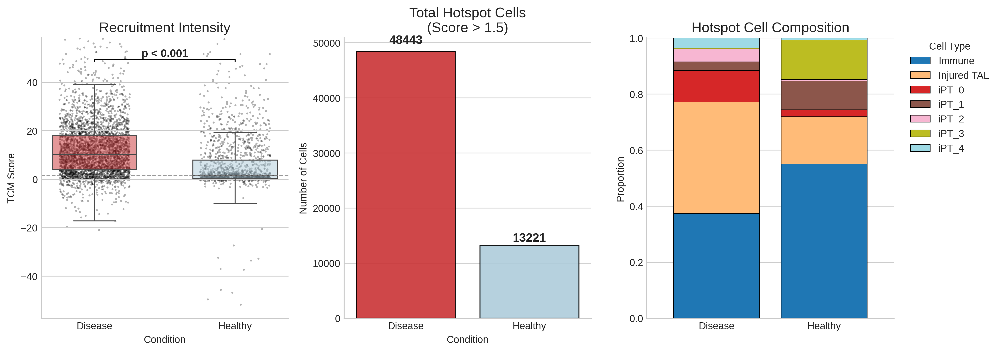

In [8]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import os
from scipy.stats import mannwhitneyu

print("\n--- Running Statistical Comparison & Composition Analysis ---")

# ==========================================
# CONFIGURATION (Matched to your script)
# ==========================================
# Column containing "Healthy" vs "Disease" labels
# NOTE: Ensure your adata_filtered.obs has this column.
# Based on your previous snippets, it seems to be 'type'.
CONDITION_COL = 'type'

# Matches the key used in your provided script
CELL_TYPE_COL = 'cellType_CosMx_2'
SCORE_COL = 'tcm_score_hotspot'

# Uses the variable defined in your script
THRESHOLD = RECRUITMENT_THRESHOLD

# ==========================================
# 1. PREPARE DATA
# ==========================================
# Extract necessary columns
stats_df = adata_filtered.obs[[SCORE_COL, CONDITION_COL, CELL_TYPE_COL]].copy()
stats_df = stats_df.rename(
    columns={
        CONDITION_COL: 'Condition',
        SCORE_COL: 'Recruitment_Score',
        CELL_TYPE_COL: 'Cell_Type'
    }
)
stats_df = stats_df.dropna()

# ==========================================
# 2. CALCULATE STATISTICS
# ==========================================
healthy_scores = stats_df[stats_df['Condition']
                          == 'Healthy']['Recruitment_Score']
disease_scores = stats_df[stats_df['Condition']
                          == 'Disease']['Recruitment_Score']

p_text = "N/A"
if len(healthy_scores) > 0 and len(disease_scores) > 0:
    stat, p_val = mannwhitneyu(
        disease_scores, healthy_scores, alternative='greater')
    if p_val < 0.001:
        p_text = "p < 0.001"
    else:
        p_text = f"p={p_val:.3f}"
else:
    print("Warning: Missing data for one or both conditions (Healthy/Disease).")

# ==========================================
# 3. GENERATE PLOTS
# ==========================================
fig, axes = plt.subplots(1, 3, figsize=(14, 5))

# -------------------------------------------------------
# PLOT A: Transparent Box Plot + Strip Plot
# -------------------------------------------------------
ax = axes[0]

# 1. Strip Plot (Bottom Layer - The Dots)
# Downsample if dataset is massive (>5000 points) to prevent lag
if len(stats_df) > 5000:
    plot_data = stats_df.sample(5000)
else:
    plot_data = stats_df

sns.stripplot(
    data=plot_data, x='Condition', y='Recruitment_Score',
    color='black', size=2, alpha=0.3, jitter=0.25, ax=ax, zorder=0
)

# 2. Box Plot (Top Layer - Transparent)
box = sns.boxplot(
    data=stats_df, x='Condition', y='Recruitment_Score',
    palette={'Healthy': '#a6cee3', 'Disease': '#e31a1c'},
    showfliers=False, width=0.6, linewidth=1, ax=ax, zorder=1
)

# --- TRANSPARENCY MAGIC ---
# Iterate over the box patches to make them 50% transparent
for patch in box.patches:
    r, g, b, a = patch.get_facecolor()
    patch.set_facecolor((r, g, b, 0.5))
# --------------------------

# 3. Annotations (Significance Bracket)
y_max = stats_df['Recruitment_Score'].quantile(0.99)
y_line = y_max * 1.05
y_text = y_line * 1.02
ax.set_ylim(top=y_line * 1.2)

# Get x-positions for Healthy/Disease
conditions = sorted(stats_df['Condition'].unique())
try:
    x_h = conditions.index('Healthy')
    x_d = conditions.index('Disease')

    # Draw bracket
    ax.plot([x_h, x_h, x_d, x_d], [y_line, y_line *
            1.02, y_line*1.02, y_line], lw=1, c='k')
    ax.text((x_h + x_d)/2, y_text, p_text, ha='center',
            va='bottom', fontsize=11, fontweight='bold')
except ValueError:
    pass

ax.axhline(y=THRESHOLD, color='gray', linestyle='--',
           linewidth=1, alpha=0.8, label='Threshold')
ax.set_title("Recruitment Intensity", fontsize=14)
ax.set_ylabel("TCM Score")
sns.despine(ax=ax)


# -------------------------------------------------------
# PLOT B: Total Hotspot Numbers (Absolute Count)
# -------------------------------------------------------
ax = axes[1]

# Filter data to only include cells ABOVE the threshold (Hotspots)
hotspots = stats_df[stats_df['Recruitment_Score'] > THRESHOLD].copy()

# Count hotspots per condition
counts = hotspots['Condition'].value_counts().reindex(
    ['Disease','Healthy', ]).fillna(0)
counts_df = counts.reset_index()
counts_df.columns = ['Condition', 'Count']

sns.barplot(
    data=counts_df, x='Condition', y='Count',
    palette={'Healthy': '#a6cee3', 'Disease': '#e31a1c'},
    edgecolor='black', linewidth=1, ax=ax, alpha=0.9
)

# Label bars with exact numbers
for i, v in enumerate(counts_df['Count']):
    ax.text(i, v + (v*0.02), int(v), ha='center',
            va='bottom', fontsize=12, fontweight='bold')

ax.set_title("Total Hotspot Cells\n(Score > 1.5)", fontsize=14)
ax.set_ylabel("Number of Cells")
sns.despine(ax=ax)


# -------------------------------------------------------
# PLOT C: Cell Type Composition (Proportion 0-1)
# -------------------------------------------------------
ax = axes[2]

if not hotspots.empty:
    # 1. Create a matrix: Rows=Condition, Cols=Cell_Type, Values=Count
    comp_df = pd.crosstab(hotspots['Condition'], hotspots['Cell_Type'])

    # 2. Normalize rows to sum to 1 (Proportion)
    comp_pct = comp_df.div(comp_df.sum(axis=1), axis=0)

    # 3. Stacked Bar Plot
    # Using 'tab20' colormap to handle many cell types distinctly
    comp_pct.plot(
        kind='bar', stacked=True, ax=ax,
        colormap='tab20', width=0.8, edgecolor='black', linewidth=0.5
    )

    ax.set_title("Hotspot Cell Composition", fontsize=14)
    ax.set_ylabel("Proportion")
    ax.set_xlabel("")
    ax.set_ylim(0, 1)

    # Move legend outside the plot area
    ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left',
              borderaxespad=0, title='Cell Type')
    sns.despine(ax=ax)

    # Ensure x-axis labels (Healthy/Disease) are horizontal
    plt.setp(ax.get_xticklabels(), rotation=0)

else:
    ax.text(0.5, 0.5, "No Hotspots Found", ha='center', va='center')
    ax.axis('off')

# ==========================================
# 4. SAVE AND SHOW
# ==========================================
plt.tight_layout()
out_path = os.path.join(
    OUTPUT_DIR, "Figure_Stats_Comparison_And_Composition.pdf")
plt.savefig(out_path, bbox_inches='tight')
print(f"Comparison plot saved to: {out_path}")
plt.show()


In [21]:
import os
import scanpy as sc

# Define the path where you want to save the processed data
# We use a new filename to differentiate it from the raw input
SAVE_PATH = "../../data/Kidney_ST/Kidney_CosMx_Hotspot_Scored.h5ad"

# Ensure the directory exists
os.makedirs(os.path.dirname(SAVE_PATH), exist_ok=True)

print(f"Saving processed AnnData to {SAVE_PATH}...")

# Check if adata_filtered exists in memory
if 'adata_filtered' in locals():
    # Verify the score column exists before saving
    if 'tcm_score_hotspot' in adata_filtered.obs.columns:
        adata_filtered.write(SAVE_PATH)
        print("Success! Data saved.")
        print(
            f"Contains {adata_filtered.n_obs} cells with 'tcm_score_hotspot'.")
    else:
        print("Error: 'tcm_score_hotspot' column missing. Run the TCM analysis first.")
else:
    print("Error: 'adata_filtered' object not found in memory.")


Saving processed AnnData to ../../data/Kidney_ST/Kidney_CosMx_Hotspot_Scored.h5ad...


Success! Data saved.
Contains 83204 cells with 'tcm_score_hotspot'.


Loading ../../data/Kidney_ST/Kidney_CosMx_Hotspot_Scored.h5ad...
Calculating metrics...
Using 61664 cells (Hotspot Score > 1.5) for composition.
   CSVs saved (Filtered by Hotspot Score).
   Generating 3-panel plot...


   Plots saved to: ../../analysis/hotspot_dashboard/9_hotspot_dashboard_filtered_custom_ticks.png & .pdf


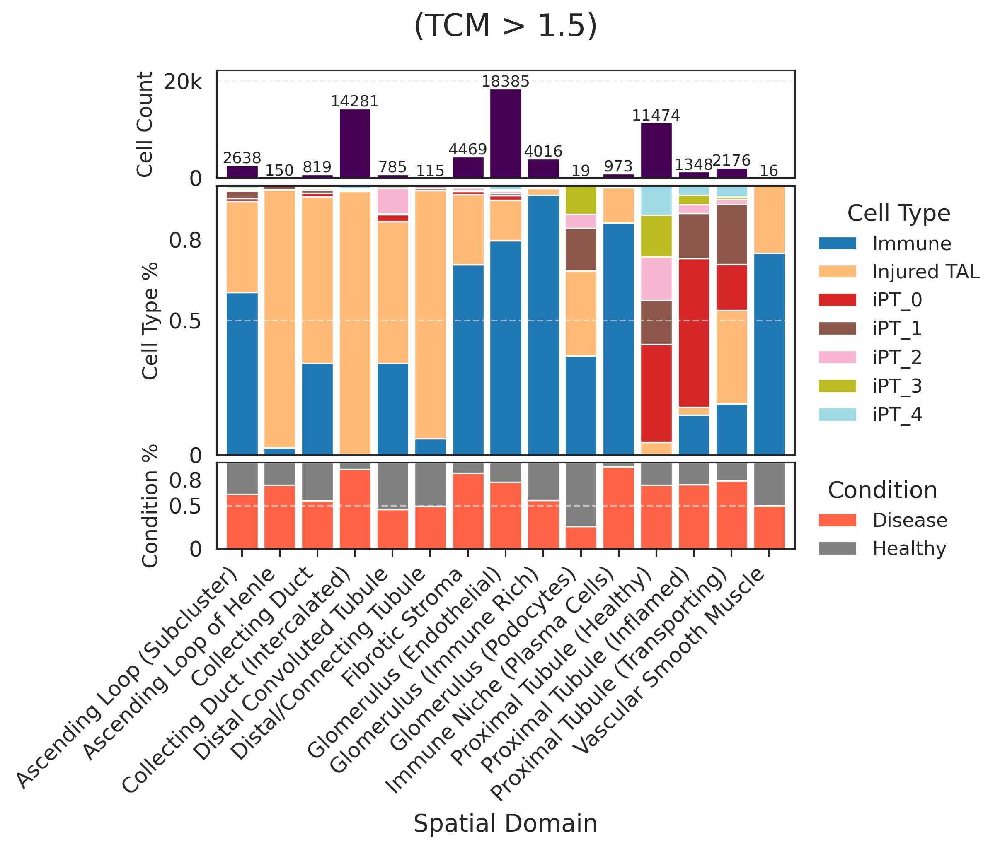

In [19]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import warnings
from matplotlib.ticker import FuncFormatter

# --- VISUALIZATION SETTINGS (WHITE THEME) ---
warnings.filterwarnings('ignore')
sns.set_style("white")
sns.set_context("paper", font_scale=1.4)
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['axes.facecolor'] = 'white'
plt.rcParams['savefig.facecolor'] = 'white'

# --- CONFIGURATION ---
INPUT_FILE = "../../data/Kidney_ST/Kidney_CosMx_Hotspot_Scored.h5ad"
ANALYSIS_DIR = "../../analysis/hotspot_dashboard"
os.makedirs(ANALYSIS_DIR, exist_ok=True)

# VARIABLES
SCORE_COLUMN = 'tcm_score_hotspot'
THRESHOLD = 1.5

# KEYS
DOMAIN_KEY = 'BANKSY_Domain_Annotated'
CELL_TYPE_KEY = 'cellType_CosMx_2'
CONDITION_KEY = 'type'

# --- LOAD DATA ---
print(f"Loading {INPUT_FILE}...")
adata = sc.read_h5ad(INPUT_FILE)
adata.obs[DOMAIN_KEY] = adata.obs[DOMAIN_KEY].astype(str).astype('category')

# --- DATA PROCESSING ---
print("Calculating metrics...")

# 1. Get list of ALL domains (from the full dataset)
all_domains = sorted(adata.obs[DOMAIN_KEY].unique())

# --- PART A: FILTERED DATASET FOR ALL PANELS ---
# Define the filtered subset based on the threshold
hotspot_subset = adata.obs[adata.obs[SCORE_COLUMN] > THRESHOLD]
print(
    f"Using {hotspot_subset.shape[0]} cells (Hotspot Score > {THRESHOLD}) for composition.")

# --- Top Panel Data: HOTSPOT COUNTS (Filtered > 1.5) ---
df_counts = hotspot_subset[DOMAIN_KEY].value_counts().reindex(
    all_domains, fill_value=0)

# --- Middle Panel Data: Cell Type Composition (FILTERED Cells) ---
df_celltype = pd.crosstab(
    hotspot_subset[DOMAIN_KEY], hotspot_subset[CELL_TYPE_KEY], normalize='index')
df_celltype = df_celltype.reindex(all_domains, fill_value=0)

# --- Bottom Panel Data: Condition Composition (FILTERED Cells) ---
df_condition = pd.crosstab(
    hotspot_subset[DOMAIN_KEY], hotspot_subset[CONDITION_KEY], normalize='index')
df_condition = df_condition.reindex(all_domains, fill_value=0)

# --- SAVE CSVs ---
df_counts.to_csv(os.path.join(ANALYSIS_DIR, "9_top_panel_hotspot_counts.csv"))
df_celltype.to_csv(os.path.join(
    ANALYSIS_DIR, "9_middle_panel_hotspot_celltype.csv"))
df_condition.to_csv(os.path.join(
    ANALYSIS_DIR, "9_bottom_panel_hotspot_condition.csv"))
print("   CSVs saved (Filtered by Hotspot Score).")

# --- PLOTTING ---
print("   Generating 3-panel plot...")

# Layout: 3 Rows, sharing X axis
fig, (ax1, ax2, ax3) = plt.subplots(
    nrows=3, ncols=1,
    sharex=True,
    figsize=(6, 5),
    gridspec_kw={'height_ratios': [1, 2.5, 0.8], 'hspace': 0.05}
)
fig.patch.set_facecolor('white')

# Y-axis formatting functions (defined once)


def thousands_formatter(x, pos):
    'For ax1: Formats thousands with k suffix'
    if x >= 1000:
        return f'{x/1000:.0f}k'
    return f'{x:.0f}'


def composition_formatter(x, pos):
    'For ax2 & ax3: Formats 0/1 as integers, others as .1f'
    if x == 0 or x == 1:
        return f'{x:.0f}'
    return f'{x:.1f}'


formatter_k = FuncFormatter(thousands_formatter)
formatter_comp = FuncFormatter(composition_formatter)


# =========================================================================
# PANEL 1: HOTSPOT COUNTS (Filtered > 1.5)
# =========================================================================
df_counts.plot(kind='bar', ax=ax1, color='#440154', width=0.85)
ax1.set_title(
    f'(TCM > {THRESHOLD})', fontsize=18, pad=20)
ax1.set_ylabel('Cell Count', fontsize=12)
ax1.grid(axis='y', linestyle='--', alpha=0.3)
ax1.legend().remove()

# Apply 'k' formatting
ax1.yaxis.set_major_formatter(formatter_k)

# Increase y-axis limit/margin and ensure 20k tick
max_count = df_counts.max()
margin_factor = 1.2  # 20% margin for text clearance
y_limit_data = max_count * margin_factor
target_20k = 20000
# Ensure 20k is comfortably included
y_limit = max(y_limit_data, target_20k * 1.05)

ax1.set_ylim(0, y_limit)
existing_ticks = list(ax1.get_yticks())
if 20000 not in existing_ticks:
    new_ticks = sorted(list(set(existing_ticks) | {target_20k}))
    ax1.set_yticks(new_ticks)

# Add count labels on top of bars
for i, v in enumerate(df_counts):
    if v > 0:
        ax1.text(i, v + (max_count * 0.02),
                 str(int(v)), ha='center', fontsize=9)

# =========================================================================
# PANEL 2: CELL TYPE PROPORTION (Filtered Cells)
# =========================================================================
df_celltype.plot(kind='bar', stacked=True,
                 width=0.85, ax=ax2, colormap='tab20')
ax2.set_ylabel('Cell Type %', fontsize=12)
ax2.legend(bbox_to_anchor=(1.01, 1), loc='upper left', frameon=False,
           title="Cell Type", fontsize='small')
ax2.set_ylim(0, 1)
ax2.grid(False)

# Y-axis ticks for 0, 0.5, 0.8, and custom formatting
ax2.set_yticks([0, 0.5, 0.8])
ax2.yaxis.set_major_formatter(formatter_comp)
ax2.axhline(0.5, color='white', linestyle='--', linewidth=1, alpha=0.5)

# =========================================================================
# PANEL 3: CONDITION PROPORTION (Filtered Cells)
# =========================================================================
colors =  ['tomato', 'grey']  # Blue, Red, Green
df_condition.plot(kind='bar', stacked=True, width=0.85, ax=ax3, color=colors)
ax3.set_ylabel('Condition %', fontsize=12)
ax3.legend(bbox_to_anchor=(1.01, 1), loc='upper left', frameon=False,
           title="Condition", fontsize='small')
ax3.set_ylim(0, 1)
ax3.grid(False)

# Y-axis ticks for 0, 0.5, 0.8, and custom formatting
ax3.set_yticks([0, 0.5, 0.8])
ax3.yaxis.set_major_formatter(formatter_comp)

# Reference line
ax3.axhline(0.5, color='white', linestyle='--', linewidth=1, alpha=0.5)

# FORMATTING
ax3.set_xlabel('Spatial Domain', fontsize=14)
plt.xticks(rotation=45, ha='right')
# Ensure the actual tick marks are visible on the bottom axis
ax3.tick_params(axis='x', which='both', bottom=True,
                top=False, labelbottom=True)
# Remove x-axis ticks from top panels
ax1.tick_params(labelbottom=False)
ax2.tick_params(labelbottom=False)

# --- SAVE PLOTS ---
save_base = os.path.join(
    ANALYSIS_DIR, "9_hotspot_dashboard_filtered_custom_ticks")
plt.savefig(f"{save_base}.png", dpi=300,
            bbox_inches='tight', facecolor='white')
plt.savefig(f"{save_base}.pdf", bbox_inches='tight', facecolor='white')
print(f"   Plots saved to: {save_base}.png & .pdf")

plt.show()


In [23]:
# %%
import scanpy as sc
import pandas as pd

# --- CONFIGURATION ---
INPUT_FILE = "../../data/Kidney_ST/Kidney_CosMx_Hotspot_Scored.h5ad"

# --- 1. LOAD DATA ---
print(f"Loading {INPUT_FILE}...")
adata = sc.read_h5ad(INPUT_FILE)

# --- 2. PRINT ALL COLUMNS ---
print("\n--- ALL AVAILABLE METADATA (adata.obs) ---")
for col in adata.obs.columns:
    print(f" - {col}")

# --- 3. SEARCH FOR SPECIFIC TERMS (Optional) ---
# Use this to find scores if the list is too long
print("\n--- SEARCH RESULTS (containing 'score' or 'hotspot') ---")
search_terms = ['score', 'hotspot']
found_cols = [c for c in adata.obs.columns if any(
    term in c.lower() for term in search_terms)]

if found_cols:
    print(f"Found {len(found_cols)} matches:")
    for col in found_cols:
        print(f" -> {col}")
else:
    print("No columns found matching 'score' or 'hotspot'.")

# --- 4. CHECK EMBEDDINGS (UMAP, Spatial, etc.) ---
print("\n--- AVAILABLE EMBEDDINGS (adata.obsm) ---")
print(list(adata.obsm.keys()))


Loading ../../data/Kidney_ST/Kidney_CosMx_Hotspot_Scored.h5ad...

--- ALL AVAILABLE METADATA (adata.obs) ---
 - nn_33131227.a09b.4d87.addf.d7bb907597e5_1_cluster_cluster_e1ad5c7b.3174.4ee9.bfbc.d6efb6833675_1
 - RNA_nbclust_41a5ffc1.6941.4e83.af9c.d661c9c543e5_1_clusters
 - RNA_nbclust_41a5ffc1.6941.4e83.af9c.d661c9c543e5_1_posterior_probability
 - orig.ident
 - nCount_RNA
 - nFeature_RNA
 - nCount_negprobes
 - nFeature_negprobes
 - nCount_falsecode
 - nFeature_falsecode
 - fov
 - Area
 - AspectRatio
 - Width
 - Height
 - Mean.B
 - Max.B
 - Mean.CK8.18
 - Max.CK8.18
 - Mean.Membrane
 - Max.Membrane
 - Mean.R
 - Max.R
 - Mean.DAPI
 - Max.DAPI
 - cell_id
 - assay_type
 - slide_ID_numeric
 - Run_Tissue_name
 - Panel
 - cell_ID
 - x_FOV_px
 - y_FOV_px
 - x_slide_mm
 - y_slide_mm
 - propNegative
 - complexity
 - errorCtEstimate
 - percOfDataFromError
 - qcFlagsRNACounts
 - qcFlagsCellCounts
 - qcFlagsCellPropNeg
 - qcFlagsCellComplex
 - qcFlagsCellArea
 - median_negprobes
 - negprobes_quant

In [27]:
# %%
import scanpy as sc
import pandas as pd

# --- CONFIGURATION ---
INPUT_FILE = "../../data/Kidney_ST/Kidney_CosMx_Hotspot_Scored.h5ad"
CELL_TYPE_KEY = 'cellType_CosMx_2'  # The column we have been using

# --- LOAD DATA ---
print(f"Loading {INPUT_FILE}...")
adata = sc.read_h5ad(INPUT_FILE)

# --- GET UNIQUE CELL TYPES ---
if CELL_TYPE_KEY in adata.obs:
    # Get unique values and sort them
    unique_types = sorted(adata.obs[CELL_TYPE_KEY].unique().astype(str))

    print(
        f"\n✅ Found {len(unique_types)} unique cell types in '{CELL_TYPE_KEY}':")
    print("-" * 50)

    for i, cell_type in enumerate(unique_types, 1):
        print(f"{i}. {cell_type}")

    print("-" * 50)

    # Optional: Print counts for each
    print("\nCell Counts per Type:")
    print(adata.obs[CELL_TYPE_KEY].value_counts())

else:
    print(f"❌ Column '{CELL_TYPE_KEY}' not found. Available columns:")
    print(adata.obs.columns.tolist())


Loading ../../data/Kidney_ST/Kidney_CosMx_Hotspot_Scored.h5ad...

✅ Found 7 unique cell types in 'cellType_CosMx_2':
--------------------------------------------------
1. Immune
2. Injured TAL
3. iPT_0
4. iPT_1
5. iPT_2
6. iPT_3
7. iPT_4
--------------------------------------------------

Cell Counts per Type:
cellType_CosMx_2
Immune         40993
Injured TAL    24028
iPT_0           7286
iPT_1           4231
iPT_2           2425
iPT_3           2291
iPT_4           1950
Name: count, dtype: int64


Loading ../../data/Kidney_ST/Kidney_CosMx_Hotspot_Scored.h5ad...

✅ Found 11 FME genes in your panel:
   CCL2, CXCL12, MMP7, VCAM1, LCN2, CSF1, IL34, TGFB1, SPP1, FN1, COL1A1

Generating Plot 1: FME Gene Expression by Domain...
  Saved: ../../analysis/paper_validation_abedini/10_Abedini_FME_Dotplot
Generating Plot 2: Correlation Analysis...
  Saved: ../../analysis/paper_validation_abedini/11_Correlation_TCM_vs_FME

Generating Plot 3: Ligand-Receptor Spatial Map...
  Saved: ../../analysis/paper_validation_abedini/12_Spatial_LR_CCL2_CCR2

Done. Check 'analysis/paper_validation_abedini' for results.


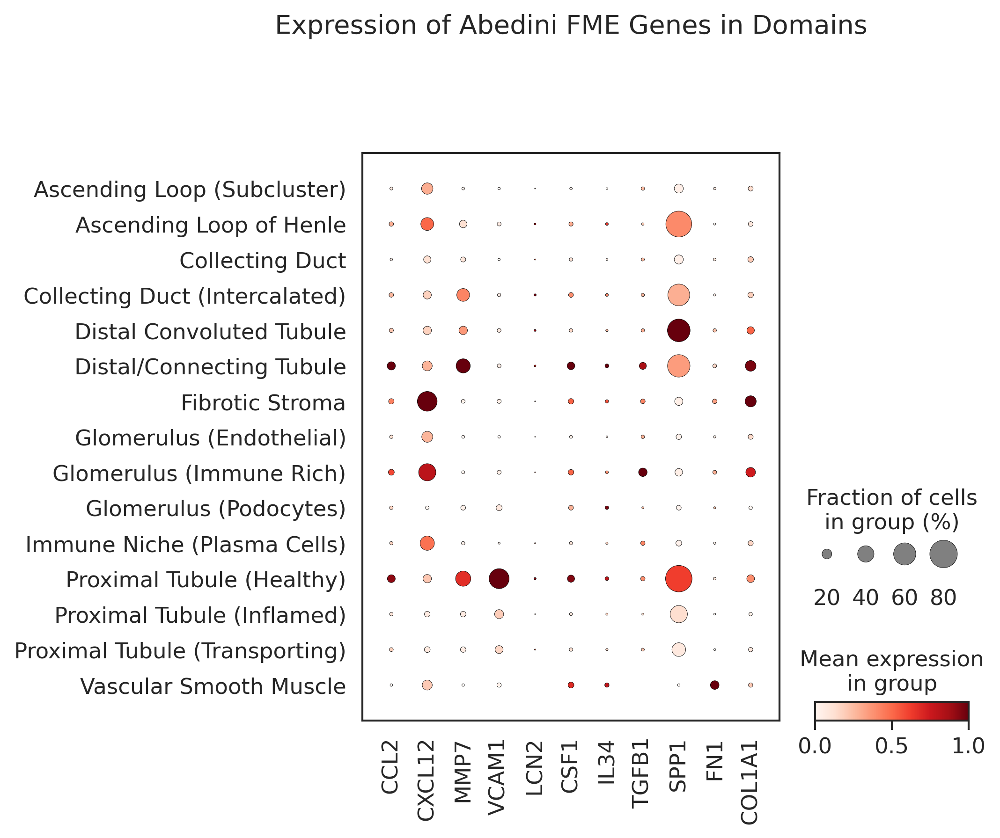

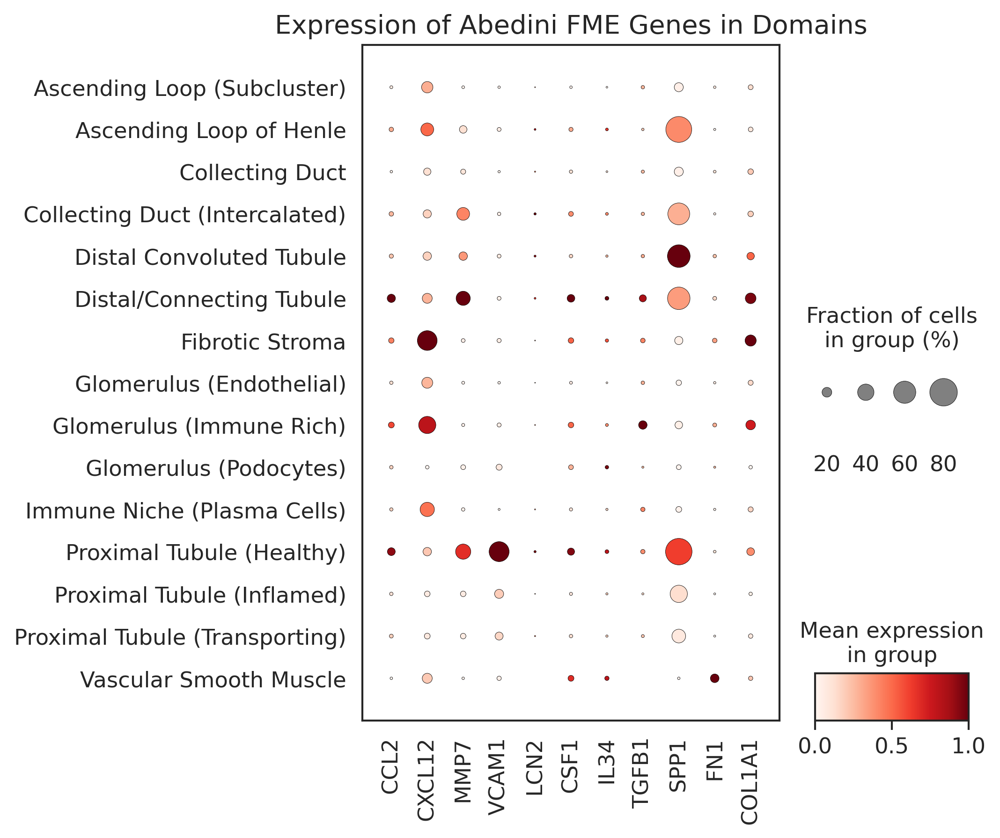

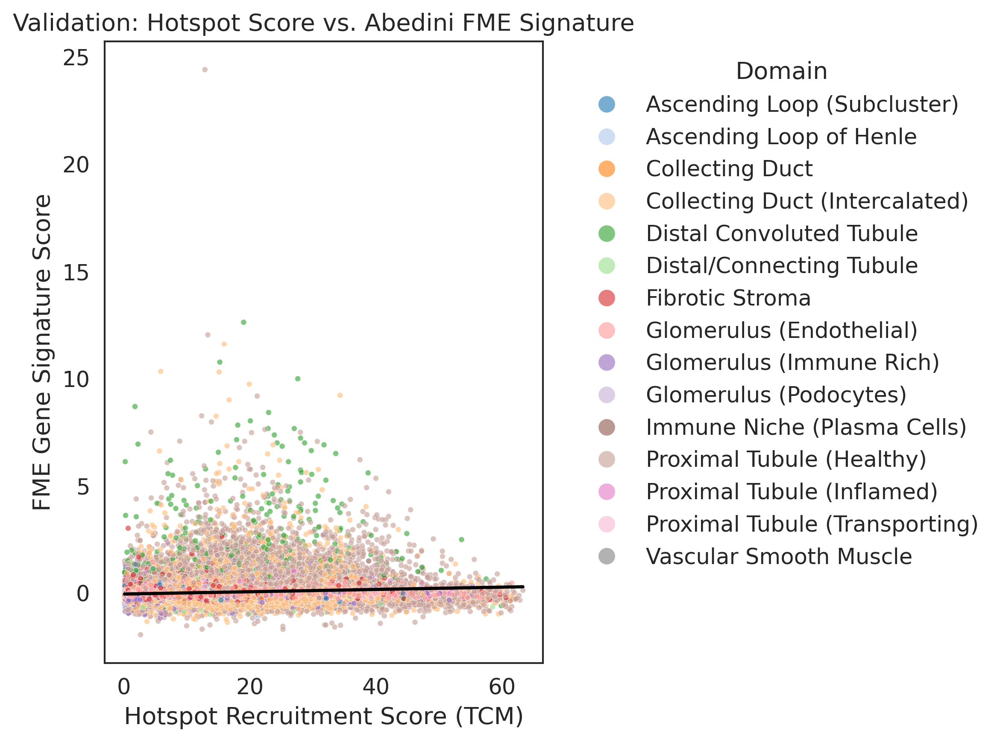

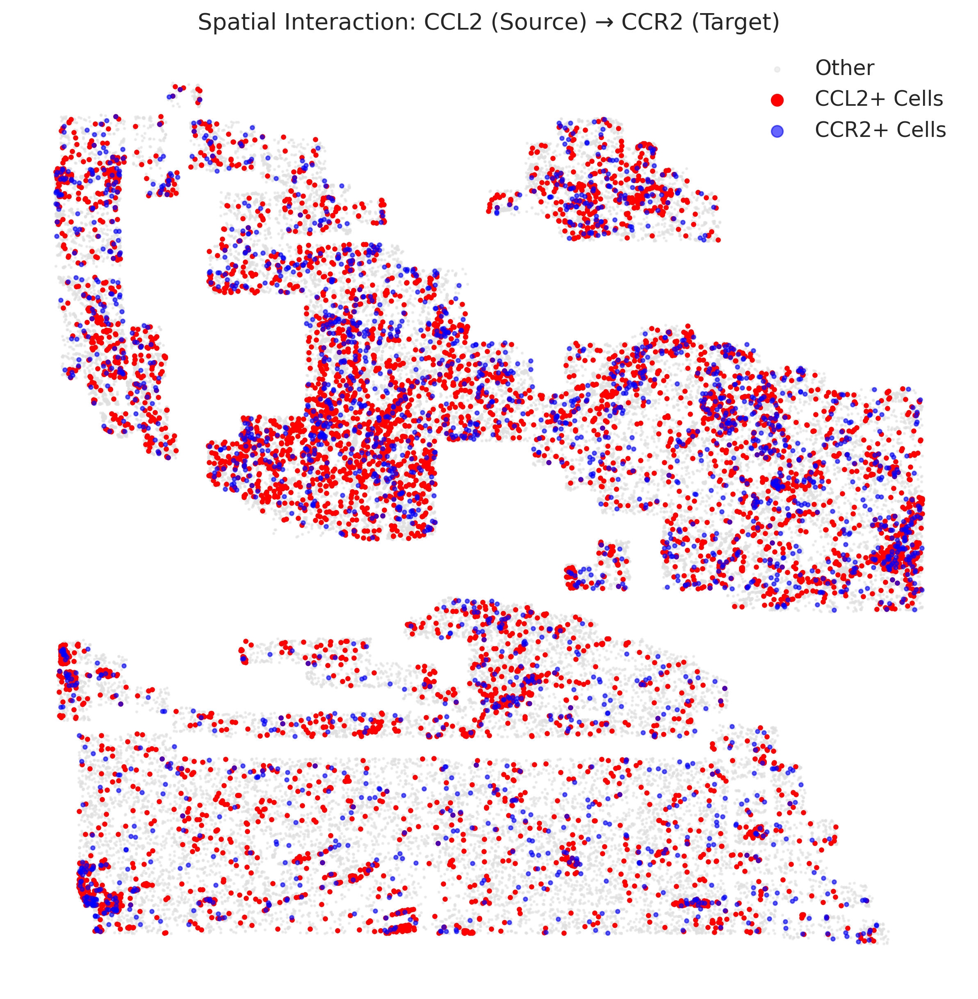

In [30]:
# %%
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os
import warnings

# --- SETTINGS ---
warnings.filterwarnings('ignore')
sns.set_style("white")
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['axes.facecolor'] = 'white'

INPUT_FILE = "../../data/Kidney_ST/Kidney_CosMx_Hotspot_Scored.h5ad"
ANALYSIS_DIR = "../../analysis/paper_validation_abedini"
os.makedirs(ANALYSIS_DIR, exist_ok=True)

# Key Columns
DOMAIN_KEY = 'BANKSY_Domain_Annotated'
SCORE_KEY = 'tcm_score_hotspot'

# --- 1. LOAD DATA ---
print(f"Loading {INPUT_FILE}...")
adata = sc.read_h5ad(INPUT_FILE)

# --- 2. DEFINE PAPER GENES (The "FME" Signature) ---
# These are the top genes highlighted in Abedini et al. 2024 for the Fibrotic Niche
fme_genes = [
    'CCL2', 'CXCL12', 'MMP7', 'VCAM1', 'LCN2',  # Pro-inflammatory / Injury Signals
    'CSF1', 'IL34',                             # Macrophage Recruiters
    'TGFB1', 'SPP1', 'FN1', 'COL1A1'            # Fibrosis Drivers
]

# Check which genes exist in your CosMx panel
available_fme = [g for g in fme_genes if g in adata.var_names]
missing_fme = [g for g in fme_genes if g not in adata.var_names]

print(f"\n✅ Found {len(available_fme)} FME genes in your panel:")
print(f"   {', '.join(available_fme)}")
if missing_fme:
    print(f"⚠️ Missing from panel: {', '.join(missing_fme)}")

# --- 3. SCORE CELLS FOR FME SIGNATURE ---
# We calculate an aggregate score for these genes
if available_fme:
    sc.tl.score_genes(adata, gene_list=available_fme,
                      score_name='Abedini_FME_Score')

    # --- PLOT 1: DO HOTSPOTS EXPRESS FME GENES? (Dot Plot) ---
    print("\nGenerating Plot 1: FME Gene Expression by Domain...")
    fig_dp = sc.pl.dotplot(
        adata,
        var_names=available_fme,
        groupby=DOMAIN_KEY,
        standard_scale='var',  # Scale 0-1 for clarity
        title="Expression of Abedini FME Genes in Domains",
        cmap='Reds',
        return_fig=True
    )

    # Save
    dp_path = os.path.join(ANALYSIS_DIR, "10_Abedini_FME_Dotplot")
    fig_dp.savefig(f"{dp_path}.png", dpi=300, bbox_inches='tight')
    fig_dp.savefig(f"{dp_path}.pdf", bbox_inches='tight')
    print(f"  Saved: {dp_path}")

    # --- PLOT 2: CORRELATION (Hotspot Score vs FME Signature) ---
    # Does the recruitment score (TCM) correlate with the biological signature?
    print("Generating Plot 2: Correlation Analysis...")

    df_corr = adata.obs[[SCORE_KEY, 'Abedini_FME_Score', DOMAIN_KEY]].copy()

    # Filter for active regions to reduce noise
    df_corr = df_corr[df_corr[SCORE_KEY] > 0.1]

    fig, ax = plt.subplots(figsize=(8, 6))
    sns.scatterplot(
        data=df_corr,
        x=SCORE_KEY,
        y='Abedini_FME_Score',
        hue=DOMAIN_KEY,
        palette='tab20',
        s=10,
        alpha=0.6,
        ax=ax
    )

    # Add trend line
    sns.regplot(
        data=df_corr, x=SCORE_KEY, y='Abedini_FME_Score',
        scatter=False, color='black', ax=ax
    )

    ax.set_title("Validation: Hotspot Score vs. Abedini FME Signature")
    ax.set_xlabel("Hotspot Recruitment Score (TCM)")
    ax.set_ylabel("FME Gene Signature Score")
    ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left',
              markerscale=3, title="Domain")
    plt.tight_layout()

    corr_path = os.path.join(ANALYSIS_DIR, "11_Correlation_TCM_vs_FME")
    plt.savefig(f"{corr_path}.png", dpi=300)
    plt.savefig(f"{corr_path}.pdf")
    print(f"  Saved: {corr_path}")

# --- 4. PLOT SPECIFIC LIGAND-RECEPTOR PAIRS (Spatial) ---
# Key Axis: CCL2 (Ligand) -> CCR2 (Receptor)
print("\nGenerating Plot 3: Ligand-Receptor Spatial Map...")

lr_pairs = [
    ('CCL2', 'CCR2'),
    ('CXCL12', 'CXCR4'),
    ('CSF1', 'CSF1R')
]

# Filter for pairs where BOTH exist in your data
valid_pairs = [(l, r)
               for l, r in lr_pairs if l in adata.var_names and r in adata.var_names]

if valid_pairs:
    # Use the first valid pair for visualization
    ligand, receptor = valid_pairs[0]

    fig, ax = plt.subplots(figsize=(10, 10))

    # 1. Plot Background (All cells grey)
    coords = adata.obsm['spatial']
    ax.scatter(coords[:, 0], coords[:, 1], c='#e0e0e0',
               s=1, alpha=0.5, label='Other')

    # 2. Plot Ligand Expressing Cells (e.g., Red)
    mask_l = adata[:, ligand].X.toarray(
    ).flatten() > 0.5  # Threshold expression
    coords_l = coords[mask_l]
    ax.scatter(coords_l[:, 0], coords_l[:, 1],
               c='red', s=5, label=f'{ligand}+ Cells')

    # 3. Plot Receptor Expressing Cells (e.g., Blue)
    mask_r = adata[:, receptor].X.toarray().flatten() > 0.5
    coords_r = coords[mask_r]
    ax.scatter(coords_r[:, 0], coords_r[:, 1], c='blue',
               s=5, label=f'{receptor}+ Cells', alpha=0.6)

    ax.set_title(
        f"Spatial Interaction: {ligand} (Source) → {receptor} (Target)")
    ax.legend(markerscale=3)
    ax.axis('off')

    lr_path = os.path.join(ANALYSIS_DIR, f"12_Spatial_LR_{ligand}_{receptor}")
    plt.savefig(f"{lr_path}.png", dpi=300, bbox_inches='tight')
    plt.savefig(f"{lr_path}.pdf", bbox_inches='tight')
    print(f"  Saved: {lr_path}")

else:
    print("⚠️ Key L-R pairs (CCL2-CCR2, etc.) not found in this CosMx panel.")

print("\nDone. Check 'analysis/paper_validation_abedini' for results.")


Preparing data and saving CSVs...


  Saved: ../../analysis/paper_validation_abedini/Figure_Slide_PanelA_Spatial.csv
  Saved: ../../analysis/paper_validation_abedini/Figure_Slide_PanelB_DotPlot.csv
  Saved: ../../analysis/paper_validation_abedini/Figure_Slide_PanelC_Correlation.csv
Generating slide figure...
✅ Slide saved to: ../../analysis/paper_validation_abedini/Figure_Slide_FME_Validation.png


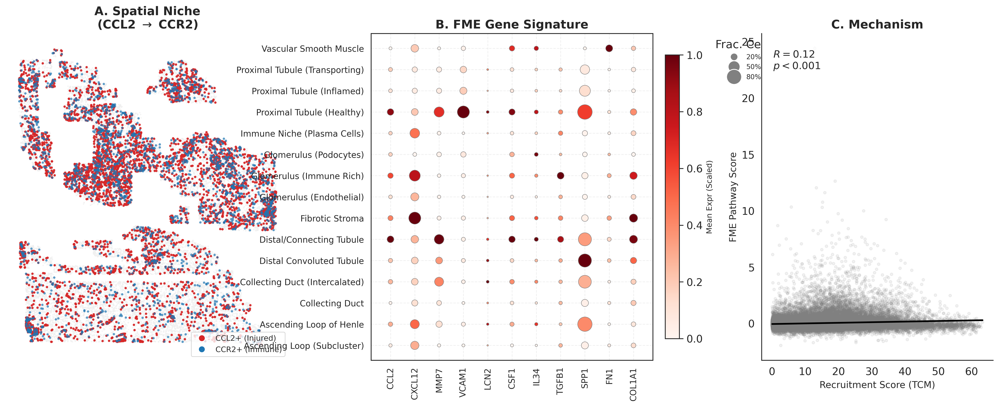

In [33]:
# %%
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os
import matplotlib.gridspec as gridspec
from matplotlib.lines import Line2D
from scipy.stats import pearsonr

# --- CONFIGURATION ---
INPUT_FILE = "../../data/Kidney_ST/Kidney_CosMx_Hotspot_Scored.h5ad"
ANALYSIS_DIR = "../../analysis/paper_validation_abedini"
os.makedirs(ANALYSIS_DIR, exist_ok=True)

# Key Columns
DOMAIN_KEY = 'BANKSY_Domain_Annotated'
SCORE_KEY = 'tcm_score_hotspot'
LIGAND, RECEPTOR = 'CCL2', 'CCR2'

# FME Genes (Abedini et al.)
fme_genes = [
    'CCL2', 'CXCL12', 'MMP7', 'VCAM1', 'LCN2',
    'CSF1', 'IL34', 'TGFB1', 'SPP1', 'FN1', 'COL1A1'
]

# --- LOAD DATA ---
if 'adata' not in locals():
    print(f"Loading {INPUT_FILE}...")
    adata = sc.read_h5ad(INPUT_FILE)

# Ensure data is ready
adata.obs[DOMAIN_KEY] = adata.obs[DOMAIN_KEY].astype('category')
available_fme = [g for g in fme_genes if g in adata.var_names]

# Calculate FME Score if missing
if available_fme and 'Abedini_FME_Score' not in adata.obs:
    sc.tl.score_genes(adata, gene_list=available_fme,
                      score_name='Abedini_FME_Score')

# --- PREPARE DATA & SAVE CSVs ---
print("Preparing data and saving CSVs...")

# ==========================================
# DATA FOR PANEL A (SPATIAL MAP)
# ==========================================
coords = adata.obsm['spatial']
mask_l = adata[:, LIGAND].X.toarray().flatten() > 0.5
mask_r = adata[:, RECEPTOR].X.toarray().flatten() > 0.5

# Create DataFrame
df_panel_a = pd.DataFrame({
    'cell_id': adata.obs_names,
    'x': coords[:, 0],
    'y': coords[:, 1],
    f'is_{LIGAND}_positive': mask_l,
    f'is_{RECEPTOR}_positive': mask_r,
    'domain': adata.obs[DOMAIN_KEY]
})

csv_a = os.path.join(ANALYSIS_DIR, "Figure_Slide_PanelA_Spatial.csv")
df_panel_a.to_csv(csv_a, index=False)
print(f"  Saved: {csv_a}")


# ==========================================
# DATA FOR PANEL B (DOT PLOT)
# ==========================================
obs_df = adata.obs[[DOMAIN_KEY]].copy()
expr_df = pd.DataFrame(adata[:, available_fme].X.toarray(
), columns=available_fme, index=adata.obs_names)
merged = pd.concat([obs_df, expr_df], axis=1)

# Mean Expression (0-1 Scaled per gene)
mean_expr = merged.groupby(DOMAIN_KEY)[available_fme].mean()
mean_expr_scaled = (mean_expr - mean_expr.min()) / \
    (mean_expr.max() - mean_expr.min())

# Fraction Expressing
fraction_expr = merged.groupby(
    DOMAIN_KEY)[available_fme].apply(lambda x: (x > 0).mean())

# Melt
plot_df = pd.merge(
    mean_expr_scaled.reset_index().melt(
        id_vars=DOMAIN_KEY, var_name='Gene', value_name='Expression'),
    fraction_expr.reset_index().melt(
        id_vars=DOMAIN_KEY, var_name='Gene', value_name='Fraction'),
    on=[DOMAIN_KEY, 'Gene']
)

csv_b = os.path.join(ANALYSIS_DIR, "Figure_Slide_PanelB_DotPlot.csv")
plot_df.to_csv(csv_b, index=False)
print(f"  Saved: {csv_b}")


# ==========================================
# DATA FOR PANEL C (CORRELATION)
# ==========================================
corr_df = adata.obs[[SCORE_KEY, 'Abedini_FME_Score']].copy()
corr_df = corr_df[corr_df[SCORE_KEY] > 0.1]  # Filter noise

csv_c = os.path.join(ANALYSIS_DIR, "Figure_Slide_PanelC_Correlation.csv")
corr_df.to_csv(csv_c)
print(f"  Saved: {csv_c}")


# --- GENERATE COMPOSITE FIGURE ---
print("Generating slide figure...")

# Set Figure Size (W x H inches) - Standard PPT Slide aspect
fig = plt.figure(figsize=(21, 7))
fig.patch.set_facecolor('white')

# Grid: 1 Row, 3 Columns. Left is wider for the map.
gs = gridspec.GridSpec(1, 3, width_ratios=[1.1, 1.2, 0.9], wspace=0.3)

# --- PANEL A: SPATIAL MAP ---
ax1 = fig.add_subplot(gs[0])

# Background
ax1.scatter(coords[:, 0], coords[:, 1], c='#f0f0f0',
            s=1, alpha=0.5, rasterized=True)
# Ligand (Red)
# Re-using the mask calculated above
ax1.scatter(coords[mask_l, 0], coords[mask_l, 1], c='#d62728',
            s=4, alpha=0.9, label=LIGAND, rasterized=True)
# Receptor (Blue)
ax1.scatter(coords[mask_r, 0], coords[mask_r, 1], c='#1f77b4',
            s=4, alpha=0.6, label=RECEPTOR, rasterized=True)

ax1.set_title(
    f"A. Spatial Niche\n({LIGAND} $\\rightarrow$ {RECEPTOR})", fontsize=14, fontweight='bold')
ax1.axis('off')
# Manual Legend
legend_elements = [Line2D([0], [0], marker='o', color='w', markerfacecolor='#d62728', label=f'{LIGAND}+ (Injured)', markersize=8),
                   Line2D([0], [0], marker='o', color='w', markerfacecolor='#1f77b4', label=f'{RECEPTOR}+ (Immune)', markersize=8)]
ax1.legend(handles=legend_elements, loc='lower right',
           fontsize=9, frameon=True)


# --- PANEL B: FME SIGNATURE (DOT PLOT) ---
ax2 = fig.add_subplot(gs[1])
scatter = ax2.scatter(
    x=plot_df['Gene'], y=plot_df[DOMAIN_KEY],
    s=plot_df['Fraction'] * 400,  # Size bubble
    c=plot_df['Expression'], cmap='Reds',
    edgecolors='grey', linewidth=0.5
)
ax2.set_title("B. FME Gene Signature", fontsize=14, fontweight='bold')
ax2.set_xlabel("")
ax2.set_ylabel("")
ax2.tick_params(axis='x', rotation=90, labelsize=10)
ax2.tick_params(axis='y', labelsize=10)
ax2.grid(True, linestyle='--', alpha=0.3)
ax2.set_xlim(-0.8, len(available_fme)-0.2)

# Legends
cbar = plt.colorbar(scatter, ax=ax2, fraction=0.046, pad=0.04)
cbar.set_label('Mean Expr (Scaled)', fontsize=9)
# Size Legend
sizes = [0.2, 0.5, 0.8]
legend_markers = [Line2D([0], [0], marker='o', color='w', markerfacecolor='grey',
                         markersize=np.sqrt(s*400), label=f'{int(s*100)}%') for s in sizes]
ax2.legend(handles=legend_markers, title="Frac. Cells", bbox_to_anchor=(
    1.2, 1), loc='upper left', fontsize=8, frameon=False)


# --- PANEL C: CORRELATION ---
ax3 = fig.add_subplot(gs[2])
sns.regplot(
    data=corr_df, x=SCORE_KEY, y='Abedini_FME_Score',
    scatter_kws={'s': 10, 'alpha': 0.1, 'color': 'grey', 'rasterized': True},
    line_kws={'color': 'black', 'linewidth': 2}, ax=ax3
)
ax3.set_title("C. Mechanism", fontsize=14, fontweight='bold')
ax3.set_xlabel("Recruitment Score (TCM)", fontsize=11)
ax3.set_ylabel("FME Pathway Score", fontsize=11)
sns.despine(ax=ax3)

# Stats
r, p = pearsonr(corr_df[SCORE_KEY], corr_df['Abedini_FME_Score'])
ax3.text(0.05, 0.95, f'$R = {r:.2f}$\n$p < 0.001$', transform=ax3.transAxes,
         verticalalignment='top', fontsize=12, bbox=dict(facecolor='white', alpha=0.8, edgecolor='none'))

# --- SAVE PLOT ---
save_name = os.path.join(ANALYSIS_DIR, "Figure_Slide_FME_Validation")
plt.savefig(f"{save_name}.png", dpi=300, bbox_inches='tight')
plt.savefig(f"{save_name}.pdf", bbox_inches='tight')
print(f"✅ Slide saved to: {save_name}.png")
plt.show()
